<a href="https://colab.research.google.com/github/juanmqc22/IAparaDevs-TechChallenge1/blob/main/TechChallenge1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tech Challenge - Fase 1
Pós-graduação: Inteligência Artificial para Desenvolvedores

Faculdade: FIAP

Turma: 7IADT

Tema: Predição de Diabetes com Machine Learning

Dataset: [Diabetes Health Indicators Dataset](https://www.kaggle.com/datasets/mohankrishnathalla/diabetes-health-indicators-dataset?resource=download) (Kaggle)

Objetivo:
Desenvolver um modelo preditivo capaz de identificar a probabilidade de um paciente apresentar diabetes, com base em informações demográficas, hábitos de vida e indicadores clínicos.

# Conhecendo os Dados

Nesta etapa, estamos fazendo a primeira inspeção do nosso dataset. O objetivo é entender rapidamente sua estrutura, identificar se há colunas com valores nulos, verificar se existem linhas duplicadas e conhecer os tipos de cada coluna (numérica ou categórica).

In [47]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv("diabetes_dataset.csv")

df.head()


,age,gender,ethnicity,education_level,income_level,employment_status,smoking_status,alcohol_consumption_per_week,physical_activity_minutes_per_week,diet_score,...,hdl_cholesterol,ldl_cholesterol,triglycerides,glucose_fasting,glucose_postprandial,insulin_level,hba1c,diabetes_risk_score,diabetes_stage,diagnosed_diabetes
0,58,Male,Asian,Highschool,Lower-Middle,Employed,Never,0,215,5.7,...,41,160,145,136,236,6.36,8.18,29.6,Type 2,1
1,48,Female,White,Highschool,Middle,Employed,Former,1,143,6.7,...,55,50,30,93,150,2.00,5.63,23.0,No Diabetes,0
2,60,Male,Hispanic,Highschool,Middle,Unemployed,Never,1,57,6.4,...,66,99,36,118,195,5.07,7.51,44.7,Type 2,1
3,74,Female,Black,Highschool,Low,Retired,Never,0,49,3.4,...,50,79,140,139,253,5.28,9.03,38.2,Type 2,1
4,46,Male,White,Graduate,Middle,Retired,Never,1,109,7.2,...,52,125,160,137,184,12.74,7.20,23.5,Type 2,1


In [48]:
df.info(show_counts=True)

df.describe()

df.isnull().sum()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 31 columns):
 #   Column                              Non-Null Count   Dtype  
---  ------                              --------------   -----  
 0   age                                 100000 non-null  int64  
 1   gender                              100000 non-null  object 
 2   ethnicity                           100000 non-null  object 
 3   education_level                     100000 non-null  object 
 4   income_level                        100000 non-null  object 
 5   employment_status                   100000 non-null  object 
 6   smoking_status                      100000 non-null  object 
 7   alcohol_consumption_per_week        100000 non-null  int64  
 8   physical_activity_minutes_per_week  100000 non-null  int64  
 9   diet_score                          100000 non-null  float64
 10  sleep_hours_per_day                 100000 non-null  float64
 11  screen_time_hours_per_day  

,0
age,0
gender,0
ethnicity,0
education_level,0
income_level,0
employment_status,0
smoking_status,0
alcohol_consumption_per_week,0
physical_activity_minutes_per_week,0
diet_score,0


In [49]:
df[df.duplicated()]

,age,gender,ethnicity,education_level,income_level,employment_status,smoking_status,alcohol_consumption_per_week,physical_activity_minutes_per_week,diet_score,...,hdl_cholesterol,ldl_cholesterol,triglycerides,glucose_fasting,glucose_postprandial,insulin_level,hba1c,diabetes_risk_score,diabetes_stage,diagnosed_diabetes


Após revisar todas as colunas do dataset, entendemos que a maioria das informações é relevante para construir nosso modelo preditivo de diabetes, pois representam fatores demográficos, hábitos de vida e indicadores clínicos. A única exceção é a coluna diabetes_stage, que indica o estágio da doença e poderia introduzir informações que não deveriam ser usadas como feature no nosso modelo inicial. Por isso, decidimos removê-la antes de prosseguir com o pré-processamento.

In [50]:
df = df.drop('diabetes_stage', axis=1)

Antes de começarmos o pré-processamento, definimos qual será a coluna target (diagnosed_diabetes), ou seja, o que nosso modelo deverá prever.

Em seguida, identificamos quais colunas são numéricas e quais são categóricas. Para evitar que a coluna target seja tratada como feature, removemos ela das listas de colunas numéricas e categóricas.

Dessa forma, garantimos que todas as etapas de pré-processamento e modelagem considerarão apenas as features corretas.

In [51]:
target = 'diagnosed_diabetes'

X = df.drop(columns=[target])
y = df[target]


num_features = df.select_dtypes(include=['int64', 'float64']).columns.tolist()
cat_features = df.select_dtypes(include=['object']).columns.tolist()

if target in num_features:
    num_features.remove(target)
if target in cat_features:
    cat_features.remove(target)

print("Colunas numéricas:", num_features)
print("Colunas categóricas:", cat_features)


Colunas numéricas: ['age', 'alcohol_consumption_per_week', 'physical_activity_minutes_per_week', 'diet_score', 'sleep_hours_per_day', 'screen_time_hours_per_day', 'family_history_diabetes', 'hypertension_history', 'cardiovascular_history', 'bmi', 'waist_to_hip_ratio', 'systolic_bp', 'diastolic_bp', 'heart_rate', 'cholesterol_total', 'hdl_cholesterol', 'ldl_cholesterol', 'triglycerides', 'glucose_fasting', 'glucose_postprandial', 'insulin_level', 'hba1c', 'diabetes_risk_score']
Colunas categóricas: ['gender', 'ethnicity', 'education_level', 'income_level', 'employment_status', 'smoking_status']


# Exploração Inicial

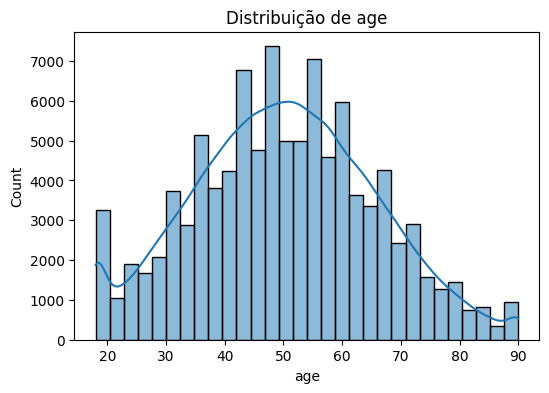

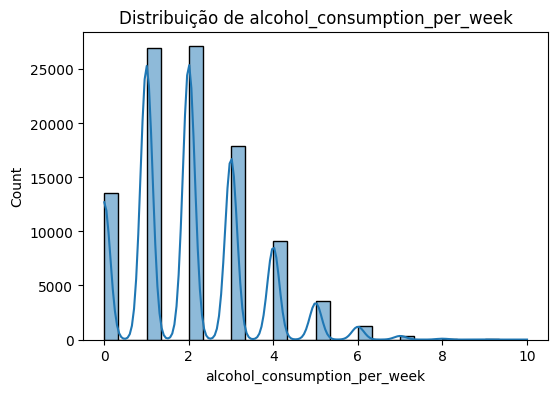

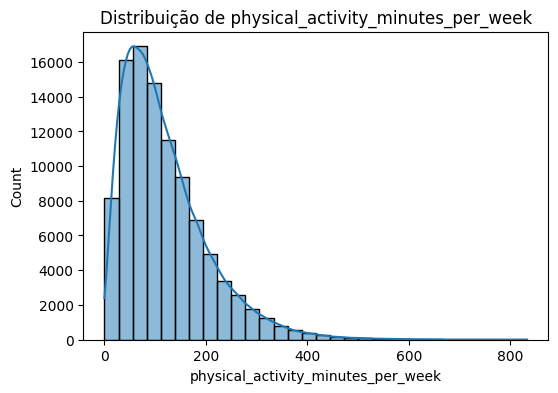

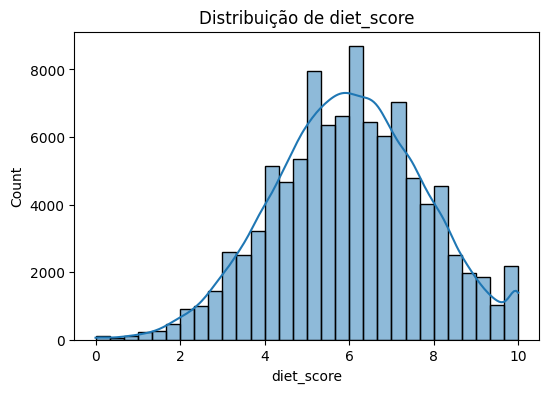

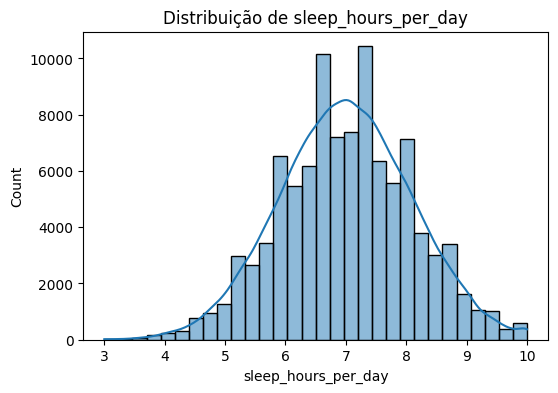

In [52]:
num_features_sample = num_features[:5]

for col in num_features_sample:
    plt.figure(figsize=(6,4))
    sns.histplot(df[col], kde=True, bins=30)
    plt.title(f'Distribuição de {col}')
    plt.show()



In [53]:
summary = pd.DataFrame()

for col in X.columns:
    summary[col] = pd.Series({
        'tipo': X[col].dtype,
        'min': X[col].min() if np.issubdtype(X[col].dtype, np.number) else np.nan,
        'max': X[col].max() if np.issubdtype(X[col].dtype, np.number) else np.nan,
        'média': X[col].mean() if np.issubdtype(X[col].dtype, np.number) else np.nan,
        'desvio': X[col].std() if np.issubdtype(X[col].dtype, np.number) else np.nan,
        'zeros': (X[col] == 0).sum() if np.issubdtype(X[col].dtype, np.number) else np.nan,
        'valores únicos': X[col].nunique()
    })

summary = summary.T  # Transpor para ficar colunas como linhas
summary


,tipo,min,max,média,desvio,zeros,valores únicos
age,int64,18,90,50.12041,15.6046,0,73
gender,object,NaN,NaN,NaN,NaN,NaN,3
ethnicity,object,NaN,NaN,NaN,NaN,NaN,5
education_level,object,NaN,NaN,NaN,NaN,NaN,4
income_level,object,NaN,NaN,NaN,NaN,NaN,5
employment_status,object,NaN,NaN,NaN,NaN,NaN,4
smoking_status,object,NaN,NaN,NaN,NaN,NaN,3
alcohol_consumption_per_week,int64,0,10,2.00367,1.417779,13535,11
physical_activity_minutes_per_week,int64,0,833,118.91164,84.409662,14,620
diet_score,float64,0.0,10.0,5.994787,1.780954,46,101


In [54]:
df = df.drop(columns=['diabetes_risk_score'])

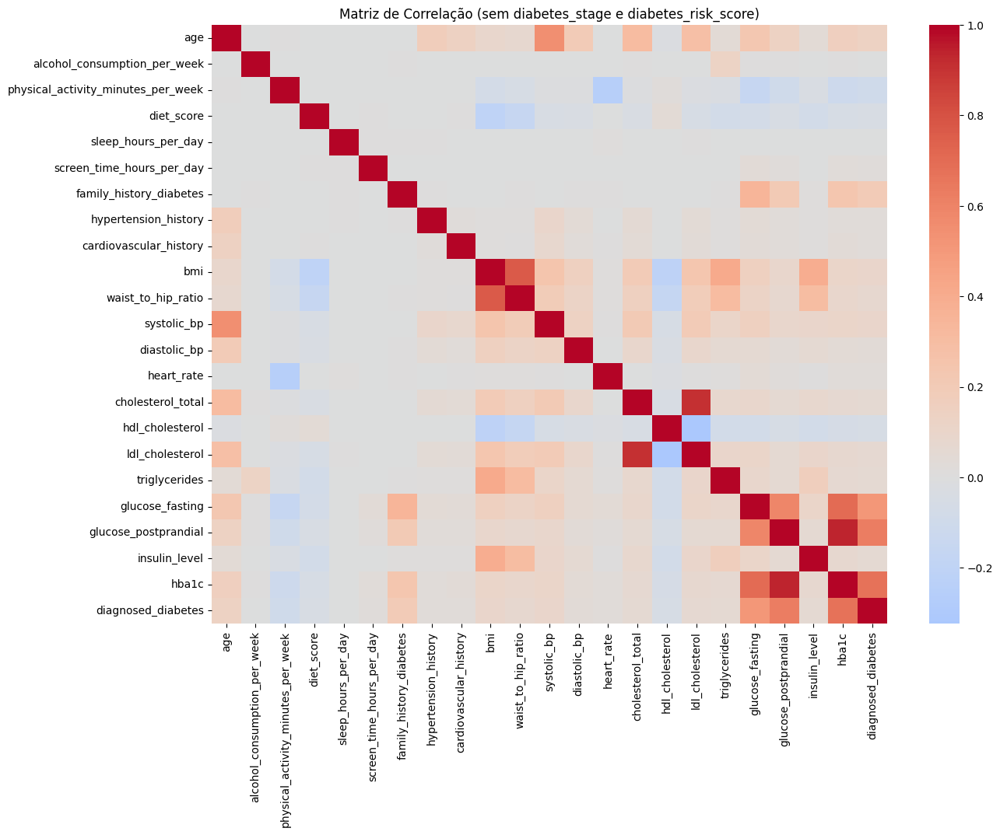

In [55]:
plt.figure(figsize=(14,10))
sns.heatmap(df.corr(numeric_only=True), cmap='coolwarm', center=0, annot=False)
plt.title("Matriz de Correlação (sem diabetes_stage e diabetes_risk_score)")
plt.show()


In [56]:
# Calcular a proporção do valor mais frequente em cada coluna
low_var = df.apply(lambda x: x.value_counts(normalize=True).iloc[0] if x.nunique() > 1 else 1)

# Ordenar da maior para a menor variabilidade
low_var = low_var.sort_values(ascending=False)

# Mostrar as colunas com mais de 90% de um único valor
print("📊 Colunas com baixa variabilidade (>90% de um mesmo valor):")
print(low_var[low_var > 0.9])

# Exibir resumo geral
print("\nResumo da variabilidade (primeiras 10 colunas):")
print(low_var.head(10))


📊 Colunas com baixa variabilidade (>90% de um mesmo valor):
cardiovascular_history    0.9208
dtype: float64

Resumo da variabilidade (primeiras 10 colunas):
cardiovascular_history     0.92080
family_history_diabetes    0.78059
hypertension_history       0.74920
employment_status          0.60175
diagnosed_diabetes         0.59998
smoking_status             0.59813
gender                     0.50216
ethnicity                  0.44997
education_level            0.44891
income_level               0.35152
dtype: float64


In [57]:
# Removendo coluna de baixa variabilidade
df = df.drop(columns=['cardiovascular_history'])


In [58]:
# Atualizando listas de colunas
num_features = df.select_dtypes(include=['int64', 'float64']).columns.tolist()
cat_features = df.select_dtypes(include=['object']).columns.tolist()

# Removendo target das listas, se estiver incluída
target = 'diagnosed_diabetes'
if target in num_features:
    num_features.remove(target)
if target in cat_features:
    cat_features.remove(target)

print("Colunas numéricas atualizadas:", num_features)
print("Colunas categóricas atualizadas:", cat_features)


Colunas numéricas atualizadas: ['age', 'alcohol_consumption_per_week', 'physical_activity_minutes_per_week', 'diet_score', 'sleep_hours_per_day', 'screen_time_hours_per_day', 'family_history_diabetes', 'hypertension_history', 'bmi', 'waist_to_hip_ratio', 'systolic_bp', 'diastolic_bp', 'heart_rate', 'cholesterol_total', 'hdl_cholesterol', 'ldl_cholesterol', 'triglycerides', 'glucose_fasting', 'glucose_postprandial', 'insulin_level', 'hba1c']
Colunas categóricas atualizadas: ['gender', 'ethnicity', 'education_level', 'income_level', 'employment_status', 'smoking_status']


                age  alcohol_consumption_per_week  \
count  100000.00000                 100000.000000   
mean       50.12041                      2.003670   
std        15.60460                      1.417779   
min        18.00000                      0.000000   
25%        39.00000                      1.000000   
50%        50.00000                      2.000000   
75%        61.00000                      3.000000   
max        90.00000                     10.000000   

       physical_activity_minutes_per_week     diet_score  sleep_hours_per_day  \
count                       100000.000000  100000.000000        100000.000000   
mean                           118.911640       5.994787             6.997818   
std                             84.409662       1.780954             1.094622   
min                              0.000000       0.000000             3.000000   
25%                             57.000000       4.800000             6.300000   
50%                            100.0

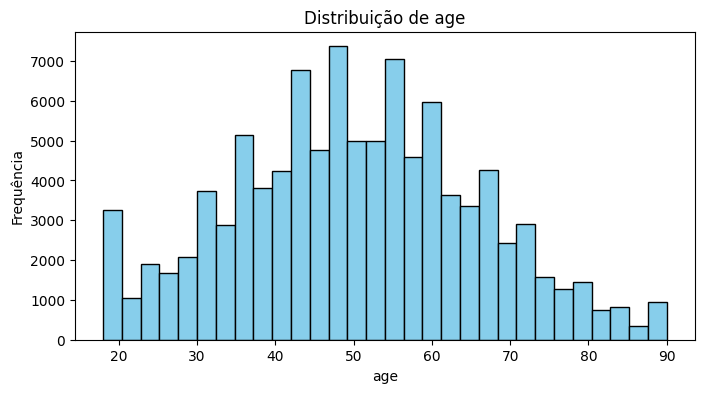

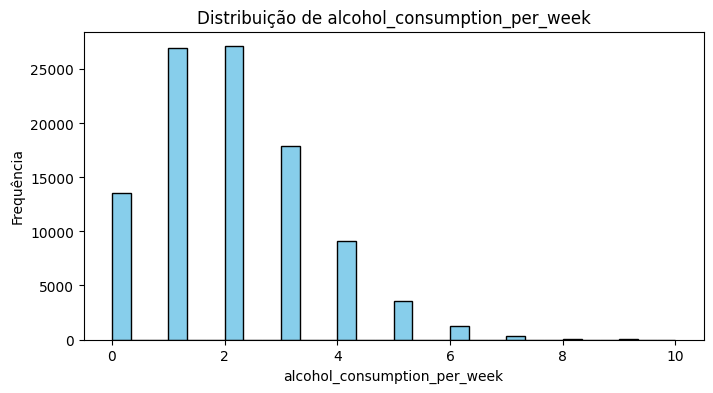

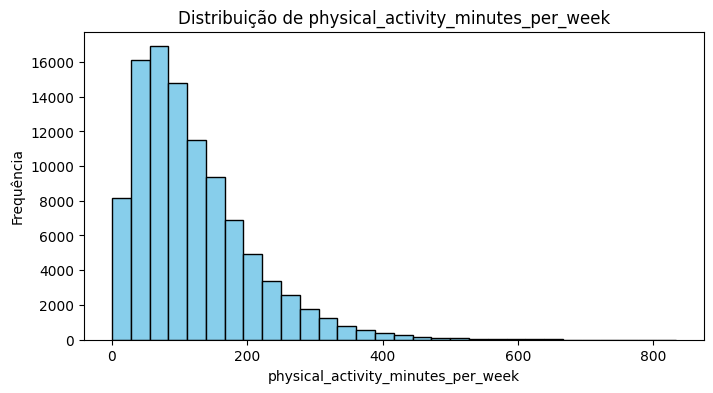

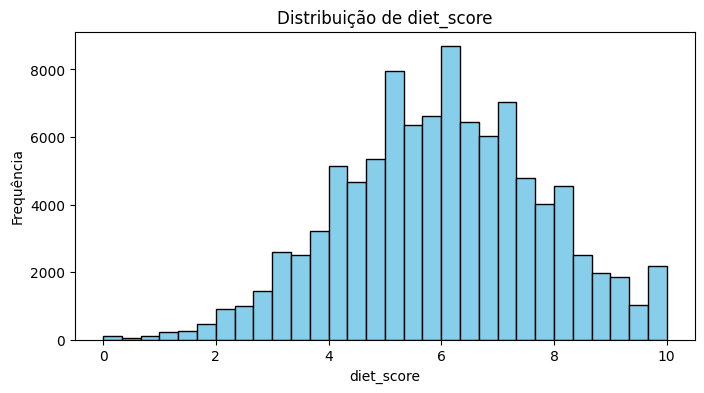

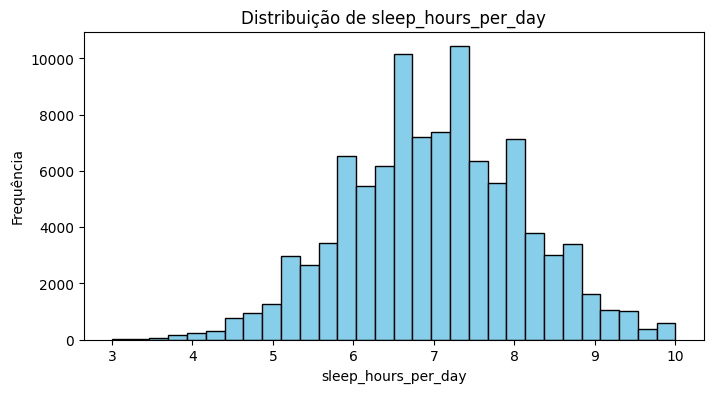

...

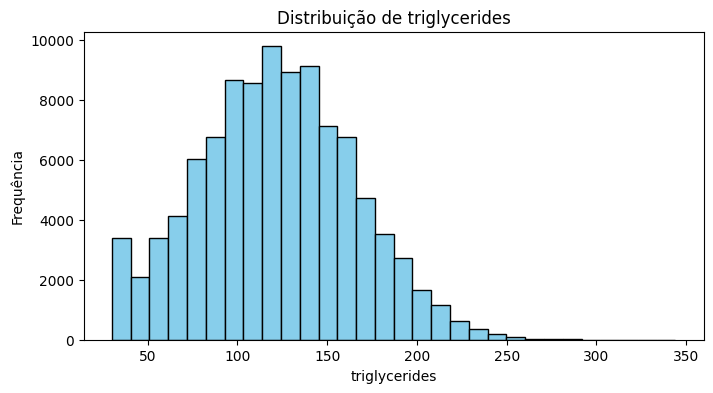

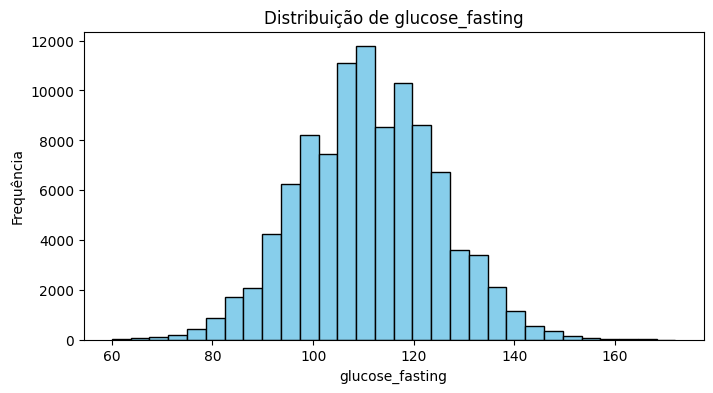

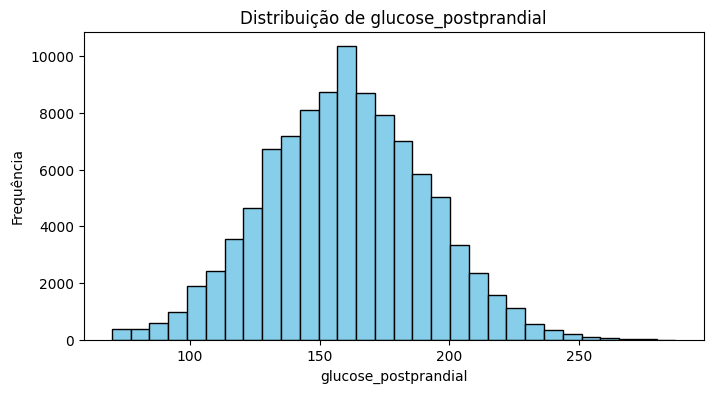

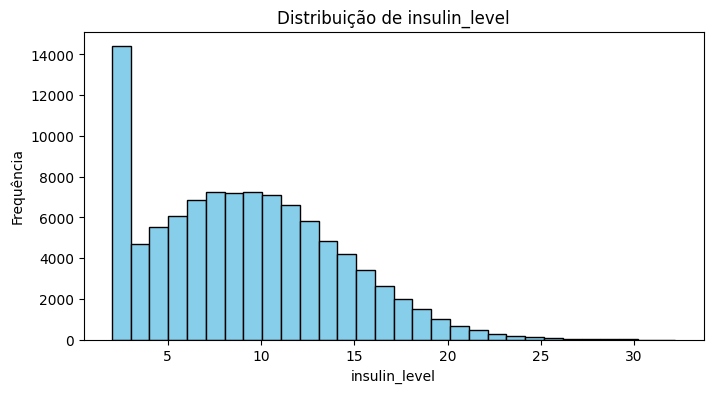

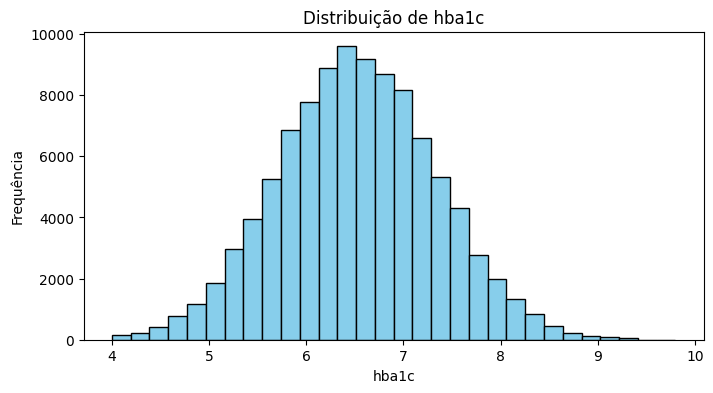

In [59]:
# Estatísticas descritivas das colunas numéricas
num_stats = df[num_features].describe()
print(num_stats)

# Histograma por coluna numérica
import matplotlib.pyplot as plt

for col in num_features:
    plt.figure(figsize=(8,4))
    plt.hist(df[col], bins=30, color='skyblue', edgecolor='black')
    plt.title(f'Distribuição de {col}')
    plt.xlabel(col)
    plt.ylabel('Frequência')
    plt.show()


In [60]:
# Função para mostrar extremos e porcentagem do valor mais comum
def column_summary(df, num_features, cat_features):
    resumo = {}

    for col in num_features:
        min_val = df[col].min()
        max_val = df[col].max()
        mean_val = df[col].mean()
        std_val = df[col].std()
        resumo[col] = {
            'Tipo': 'Numérica',
            'Min': min_val,
            'Max': max_val,
            'Média': mean_val,
            'Desvio Padrão': std_val
        }

    for col in cat_features:
        top = df[col].value_counts(normalize=True, dropna=False).idxmax()
        top_freq = df[col].value_counts(normalize=True, dropna=False).max()
        resumo[col] = {
            'Tipo': 'Categórica',
            'Valor mais comum': top,
            'Freq. do valor mais comum (%)': round(top_freq*100,2)
        }

    return pd.DataFrame(resumo).T

# Gerando resumo
summary_df = column_summary(df, num_features, cat_features)
summary_df


,Tipo,Min,Max,Média,Desvio Padrão,Valor mais comum,Freq. do valor mais comum (%)
age,Numérica,18,90,50.12041,15.6046,NaN,NaN
alcohol_consumption_per_week,Numérica,0,10,2.00367,1.417779,NaN,NaN
physical_activity_minutes_per_week,Numérica,0,833,118.91164,84.409662,NaN,NaN
diet_score,Numérica,0.0,10.0,5.994787,1.780954,NaN,NaN
sleep_hours_per_day,Numérica,3.0,10.0,6.997818,1.094622,NaN,NaN
screen_time_hours_per_day,Numérica,0.5,16.8,5.996468,2.468406,NaN,NaN
family_history_diabetes,Numérica,0,1,0.21941,0.413849,NaN,NaN
hypertension_history,Numérica,0,1,0.2508,0.433476,NaN,NaN
bmi,Numérica,15.0,39.2,25.612653,3.586705,NaN,NaN
waist_to_hip_ratio,Numérica,0.67,1.06,0.856078,0.046837,NaN,NaN


In [61]:
# Função para contar outliers por coluna
def count_outliers_iqr(df, cols):
    outliers = {}
    for col in cols:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        outliers[col] = df[(df[col] < lower_bound) | (df[col] > upper_bound)].shape[0]
    return outliers

# Contando outliers nas colunas numéricas
outliers_count = count_outliers_iqr(df, num_features)
outliers_count


{'age': 0,
 'alcohol_consumption_per_week': 458,
 'physical_activity_minutes_per_week': 3199,
 'diet_score': 337,
 'sleep_hours_per_day': 900,
 'screen_time_hours_per_day': 305,
 'family_history_diabetes': 21941,
 'hypertension_history': 0,
 'bmi': 744,
 'waist_to_hip_ratio': 273,
 'systolic_bp': 530,
 'diastolic_bp': 731,
 'heart_rate': 855,
 'cholesterol_total': 309,
 'hdl_cholesterol': 565,
 'ldl_cholesterol': 349,
 'triglycerides': 301,
 'glucose_fasting': 745,
 'glucose_postprandial': 634,
 'insulin_level': 326,
 'hba1c': 618}

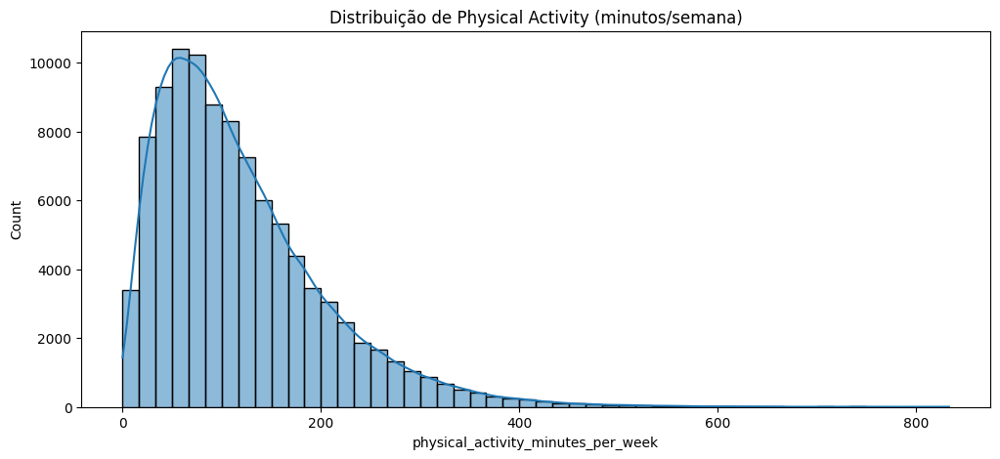

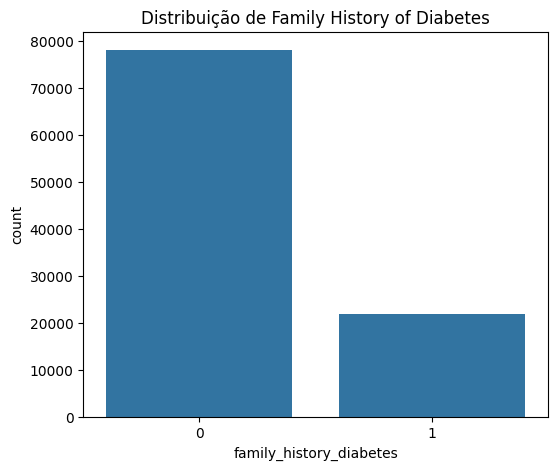

In [62]:
# Distribuição de physical_activity_minutes_per_week
plt.figure(figsize=(12,5))
sns.histplot(df['physical_activity_minutes_per_week'], bins=50, kde=True)
plt.title('Distribuição de Physical Activity (minutos/semana)')
plt.show()

# Distribuição de family_history_diabetes
plt.figure(figsize=(6,5))
sns.countplot(x='family_history_diabetes', data=df)
plt.title('Distribuição de Family History of Diabetes')
plt.show()


# Análises Exploratoria

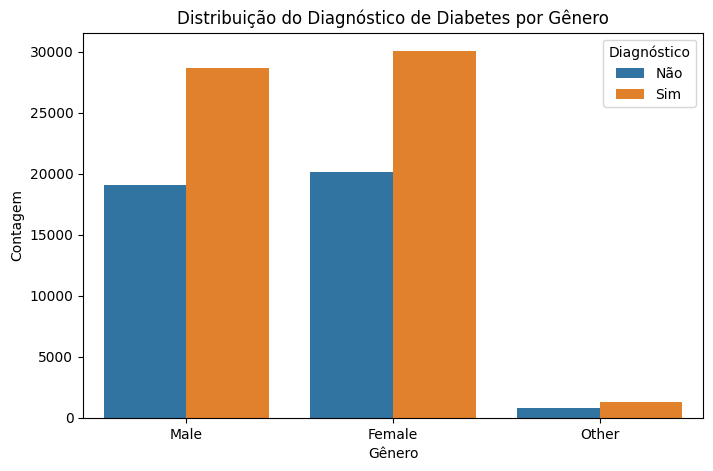

In [63]:
plt.figure(figsize=(8,5))
sns.countplot(data=df, x='gender', hue='diagnosed_diabetes')
plt.title("Distribuição do Diagnóstico de Diabetes por Gênero")
plt.xlabel("Gênero")
plt.ylabel("Contagem")
plt.legend(title="Diagnóstico", labels=["Não", "Sim"])
plt.show()



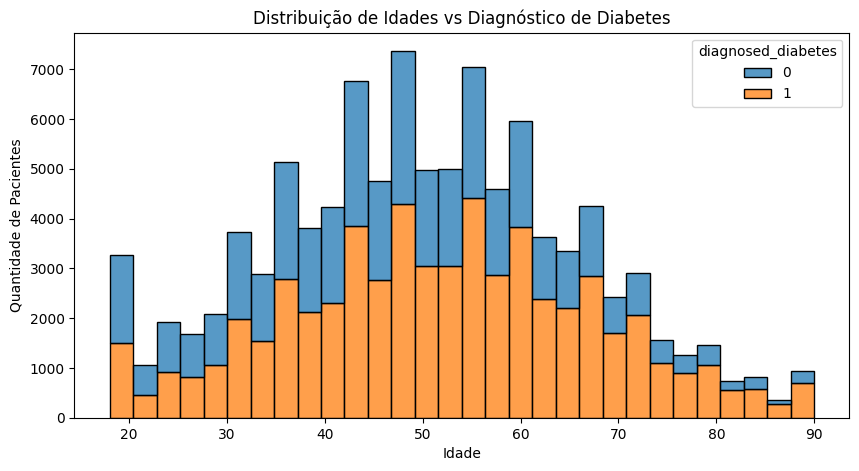

In [64]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10,5))
sns.histplot(data=df, x='age', hue='diagnosed_diabetes', multiple='stack', bins=30)
plt.title("Distribuição de Idades vs Diagnóstico de Diabetes")
plt.xlabel("Idade")
plt.ylabel("Quantidade de Pacientes")
plt.show()


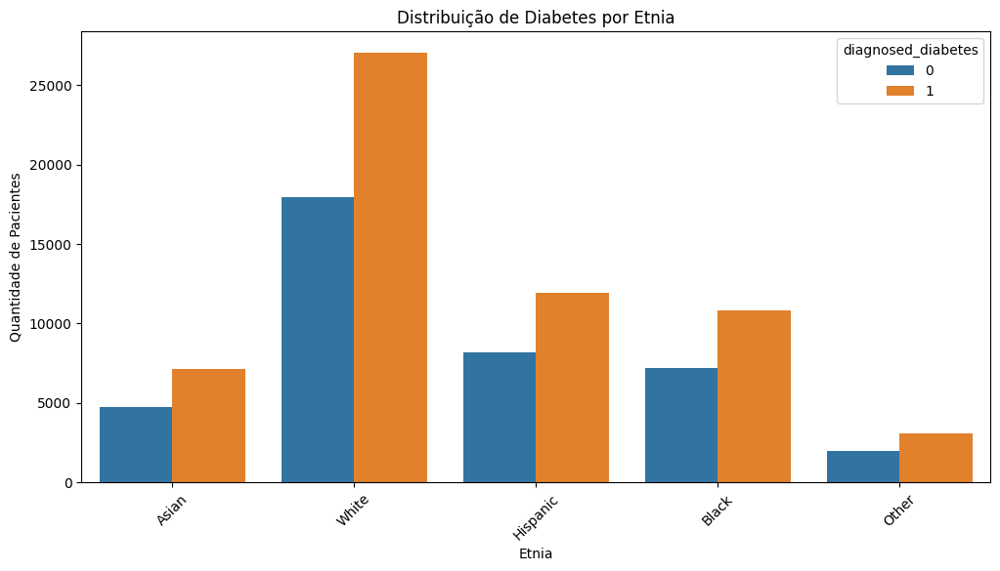

In [65]:
plt.figure(figsize=(12,6))
sns.countplot(data=df, x='ethnicity', hue='diagnosed_diabetes')
plt.title("Distribuição de Diabetes por Etnia")
plt.xlabel("Etnia")
plt.ylabel("Quantidade de Pacientes")
plt.xticks(rotation=45)
plt.show()


In [66]:
# Porcentagem de diabetes por etnia
percent_diabetes = df.groupby('ethnicity')['diagnosed_diabetes'].mean() * 100
print(percent_diabetes)


ethnicity
Asian       60.075853
Black       60.141221
Hispanic    59.394120
Other       60.764508
White       60.104007
Name: diagnosed_diabetes, dtype: float64


In [67]:
# Educação
edu = df.groupby('education_level')['diagnosed_diabetes'].mean() * 100
print("Diabetes por nível de educação (%):")
print(edu)

# Renda
inc = df.groupby('income_level')['diagnosed_diabetes'].mean() * 100
print("\nDiabetes por nível de renda (%):")
print(inc)

# Emprego
emp = df.groupby('employment_status')['diagnosed_diabetes'].mean() * 100
print("\nDiabetes por status de emprego (%):")
print(emp)


Diabetes por nível de educação (%):
education_level
Graduate        60.119302
Highschool      60.067720
No formal       60.450980
Postgraduate    59.350788
Name: diagnosed_diabetes, dtype: float64

Diabetes por nível de renda (%):
income_level
High            60.715714
Low             60.053945
Lower-Middle    60.385686
Middle          59.669436
Upper-Middle    59.866103
Name: diagnosed_diabetes, dtype: float64

Diabetes por status de emprego (%):
employment_status
Employed      60.151226
Retired       59.528514
Student       59.729906
Unemployed    60.219836
Name: diagnosed_diabetes, dtype: float64


In [68]:
cols_to_drop = ['ethnicity', 'education_level', 'income_level', 'employment_status']
df = df.drop(columns=cols_to_drop)

print("Colunas restantes:", df.columns.tolist())


Colunas restantes: ['age', 'gender', 'smoking_status', 'alcohol_consumption_per_week', 'physical_activity_minutes_per_week', 'diet_score', 'sleep_hours_per_day', 'screen_time_hours_per_day', 'family_history_diabetes', 'hypertension_history', 'bmi', 'waist_to_hip_ratio', 'systolic_bp', 'diastolic_bp', 'heart_rate', 'cholesterol_total', 'hdl_cholesterol', 'ldl_cholesterol', 'triglycerides', 'glucose_fasting', 'glucose_postprandial', 'insulin_level', 'hba1c', 'diagnosed_diabetes']


In [69]:
# Diabetes por consumo de álcool (%)
alcool = df.groupby('alcohol_consumption_per_week')['diagnosed_diabetes'].mean() * 100
print("Porcentagem de diabetes por consumo de álcool (%):\n", alcool)

# Diabetes por horas de sono (%)
sono = df.groupby('sleep_hours_per_day')['diagnosed_diabetes'].mean() * 100
print("\nPorcentagem de diabetes por horas de sono (%):\n", sono)

# Diabetes por horas de tela (%)
tela = df.groupby('screen_time_hours_per_day')['diagnosed_diabetes'].mean() * 100
print("\nPorcentagem de diabetes por horas de tela (%):\n", tela)


Porcentagem de diabetes por consumo de álcool (%):
 alcohol_consumption_per_week
0     60.251201
1     59.548064
2     60.168148
3     60.136343
4     60.539001
5     59.167822
6     60.601266
7     59.269663
8     52.873563
9     46.153846
10    50.000000
Name: diagnosed_diabetes, dtype: float64

Porcentagem de diabetes por horas de sono (%):
 sleep_hours_per_day
3.0     54.545455
3.1     33.333333
3.2     60.000000
3.3     80.000000
3.4     72.727273
          ...    
9.6     59.909910
9.7     62.275449
9.8     55.629139
9.9     57.391304
10.0    58.204334
Name: diagnosed_diabetes, Length: 71, dtype: float64

Porcentagem de diabetes por horas de tela (%):
 screen_time_hours_per_day
0.5      57.842488
0.6      57.342657
0.7      66.666667
0.8      53.513514
0.9      61.467890
           ...    
15.9    100.000000
16.0     50.000000
16.4     50.000000
16.5      0.000000
16.8      0.000000
Name: diagnosed_diabetes, Length: 156, dtype: float64


In [70]:
# Creating ranges
sleep_bins = [3, 5, 7, 9, 11]
screen_time_bins = [0, 2, 4, 6, 8, 10, 12, 17]

df['sleep_range'] = pd.cut(df['sleep_hours_per_day'], bins=sleep_bins)
df['screen_time_range'] = pd.cut(df['screen_time_hours_per_day'], bins=screen_time_bins)

# Percentage of diabetes per range
sleep_diabetes = df.groupby('sleep_range')['diagnosed_diabetes'].mean() * 100
screen_time_diabetes = df.groupby('screen_time_range')['diagnosed_diabetes'].mean() * 100

print("Percentage of diabetes by sleep range (%):")
print(sleep_diabetes)
print("\nPercentage of diabetes by screen time range (%):")
print(screen_time_diabetes)


Percentage of diabetes by sleep range (%):
sleep_range
(3, 5]     60.600425
(5, 7]     59.896740
(7, 9]     60.087632
(9, 11]    59.552042
Name: diagnosed_diabetes, dtype: float64

Percentage of diabetes by screen time range (%):
screen_time_range
(0, 2]      58.136348
(2, 4]      59.026055
(4, 6]      59.494587
(6, 8]      60.630223
(8, 10]     60.865835
(10, 12]    61.848663
(12, 17]    62.216288
Name: diagnosed_diabetes, dtype: float64


/tmp/ipython-input-2023114725.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  sleep_diabetes = df.groupby('sleep_range')['diagnosed_diabetes'].mean() * 100
/tmp/ipython-input-2023114725.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  screen_time_diabetes = df.groupby('screen_time_range')['diagnosed_diabetes'].mean() * 100


In [71]:
# Criando faixas
df['physical_activity_range'] = pd.cut(df['physical_activity_minutes_per_week'], bins=[0, 50, 100, 200, 400, 1000])
df['diet_range'] = pd.cut(df['diet_score'], bins=[0, 3, 6, 8, 10])
df['bmi_range'] = pd.cut(df['bmi'], bins=[15, 20, 25, 30, 40])

# Percentual de diabetes por faixa
activity_diabetes = df.groupby('physical_activity_range')['diagnosed_diabetes'].mean() * 100
diet_diabetes = df.groupby('diet_range')['diagnosed_diabetes'].mean() * 100
bmi_diabetes = df.groupby('bmi_range')['diagnosed_diabetes'].mean() * 100

print("Diabetes por faixa de atividade física (%):")
print(activity_diabetes)
print("\nDiabetes por faixa de dieta (%):")
print(diet_diabetes)
print("\nDiabetes por faixa de BMI (%):")
print(bmi_diabetes)


Diabetes por faixa de atividade física (%):
physical_activity_range
(0, 50]        65.262212
(50, 100]      62.532370
(100, 200]     58.835686
(200, 400]     50.699571
(400, 1000]    45.235487
Name: diagnosed_diabetes, dtype: float64

Diabetes por faixa de dieta (%):
diet_range
(0, 3]     63.897132
(3, 6]     61.730059
(6, 8]     58.493817
(8, 10]    56.478611
Name: diagnosed_diabetes, dtype: float64

Diabetes por faixa de BMI (%):
bmi_range
(15, 20]    51.031614
(20, 25]    56.615549
(25, 30]    62.039785
(30, 40]    68.388525
Name: diagnosed_diabetes, dtype: float64


/tmp/ipython-input-1687669952.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  activity_diabetes = df.groupby('physical_activity_range')['diagnosed_diabetes'].mean() * 100
/tmp/ipython-input-1687669952.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  diet_diabetes = df.groupby('diet_range')['diagnosed_diabetes'].mean() * 100
/tmp/ipython-input-1687669952.py:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  bmi_diabe

In [72]:
gender_diabetes = df.groupby('gender')['diagnosed_diabetes'].mean() * 100
print(gender_diabetes)


gender
Female    59.845468
Male      60.065730
Other     62.195728
Name: diagnosed_diabetes, dtype: float64


In [73]:
df = df.drop(columns=['gender'])


Colunas dropadas:

Ethnicity

* Analisamos a porcentagem de diagnóstico de diabetes por etnia e todos os grupos estavam muito próximos (≈60%).

* Conclusão: pouco impacto preditivo, então decidimos remover.

education_level

* Porcentagem de diabetes por nível de educação também mostrou valores muito similares entre os grupos.

* Conclusão: pouca variabilidade relevante, removida.

income_level

* Distribuição de diabetes por nível de renda igualmente muito parecida entre categorias.

* Conclusão: removida.

employment_status

* Taxa de diabetes similar entre empregados, aposentados, estudantes e desempregados.

* Conclusão: removida.

diabetes_stage

* Inicialmente dropada para não vazar informação do target para o modelo.

* Observação: pode ser útil para análise exploratória, mas não deve ser usada como feature de treino.

In [74]:
num_features = [
    'age', 'alcohol_consumption_per_week', 'physical_activity_minutes_per_week',
    'diet_score', 'sleep_hours_per_day', 'screen_time_hours_per_day',
    'family_history_diabetes', 'hypertension_history', 'bmi', 'waist_to_hip_ratio',
    'systolic_bp', 'diastolic_bp', 'heart_rate', 'cholesterol_total',
    'hdl_cholesterol', 'ldl_cholesterol', 'triglycerides',
    'glucose_fasting', 'glucose_postprandial', 'insulin_level',
    'hba1c'
]

cat_features = [
    'smoking_status', 'sono_faixa', 'tela_faixa',
    'atividade_fisica_faixa', 'dieta_faixa', 'bmi_faixa'
]


In [75]:
pd.DataFrame({
    'Coluna': df.columns,
    'Tipo': df.dtypes
})


,Coluna,Tipo
age,age,int64
smoking_status,smoking_status,object
alcohol_consumption_per_week,alcohol_consumption_per_week,int64
physical_activity_minutes_per_week,physical_activity_minutes_per_week,int64
diet_score,diet_score,float64
sleep_hours_per_day,sleep_hours_per_day,float64
screen_time_hours_per_day,screen_time_hours_per_day,float64
family_history_diabetes,family_history_diabetes,int64
hypertension_history,hypertension_history,int64
bmi,bmi,float64


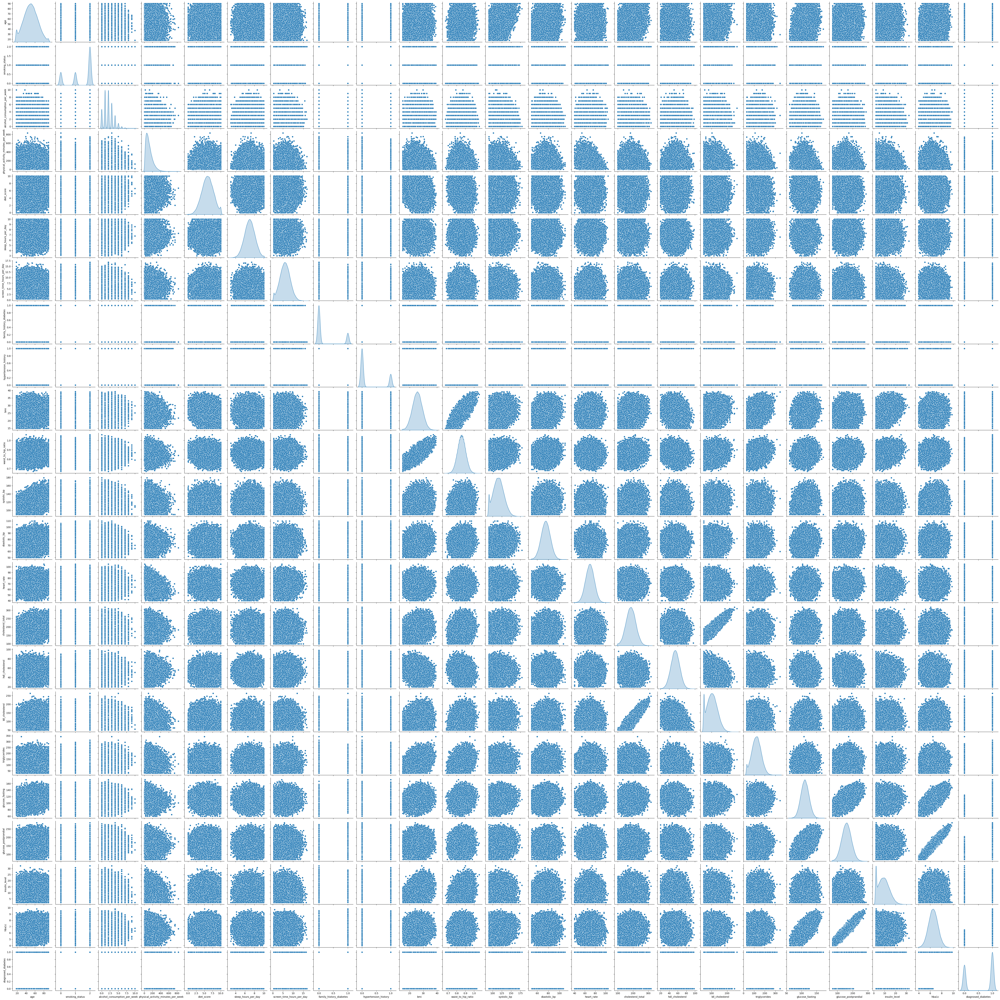

In [76]:
df_pair = df.copy()

for col in df_pair.select_dtypes(include='object'):
    df_pair[col] = df_pair[col].astype('category').cat.codes

sns.pairplot(df_pair, diag_kind='kde')
plt.show()


# Pre-Processamento

Nesta etapa, realizaremos o tratamento dos dados antes de alimentar nosso modelo. As colunas numéricas serão padronizadas usando StandardScaler, garantindo que todas tenham média 0 e desvio padrão 1, evitando que variáveis com magnitudes maiores dominem a análise. Em seguida, aplicaremos o PCA para reduzir a dimensionalidade, mantendo 95% da variância das informações.

As colunas categóricas serão transformadas em variáveis binárias (one-hot encoding), preservando suas informações sem distorcer a escala. Isso garante que o pré-processamento seja feito de forma adequada para cada tipo de dado.

In [77]:
from sklearn.preprocessing import StandardScaler
import pandas as pd

# Separando colunas numéricas e categóricas
num_features = [
    'age', 'alcohol_consumption_per_week', 'physical_activity_minutes_per_week',
    'diet_score', 'sleep_hours_per_day', 'screen_time_hours_per_day',
    'family_history_diabetes', 'hypertension_history', 'bmi', 'waist_to_hip_ratio',
    'systolic_bp', 'diastolic_bp', 'heart_rate', 'cholesterol_total',
    'hdl_cholesterol', 'ldl_cholesterol', 'triglycerides',
    'glucose_fasting', 'glucose_postprandial', 'insulin_level', 'hba1c'
]

cat_features = [
    'smoking_status', 'sleep_range', 'screen_time_range',
    'physical_activity_range', 'diet_range', 'bmi_range'
]

# 1️⃣ Padronizando as variáveis numéricas
scaler = StandardScaler()
df_scaled = pd.DataFrame(scaler.fit_transform(df[num_features]), columns=num_features)

# 2️⃣ Aplicando One-Hot Encoding nas categóricas
df_encoded = pd.get_dummies(df[cat_features], drop_first=True)

# 3️⃣ Juntando tudo
df_processed = pd.concat([df_scaled, df_encoded, df['diagnosed_diabetes']], axis=1)

print("✅ Pré-processamento concluído!")
print("Formato final:", df_processed.shape)
df_processed.head()


✅ Pré-processamento concluído!
Formato final: (100000, 43)


,age,alcohol_consumption_per_week,physical_activity_minutes_per_week,diet_score,sleep_hours_per_day,screen_time_hours_per_day,family_history_diabetes,hypertension_history,bmi,waist_to_hip_ratio,...,"physical_activity_range_(100, 200]","physical_activity_range_(200, 400]","physical_activity_range_(400, 1000]","diet_range_(3, 6]","diet_range_(6, 8]","diet_range_(8, 10]","bmi_range_(20, 25]","bmi_range_(25, 30]","bmi_range_(30, 40]",diagnosed_diabetes
0,0.504956,-1.413253,1.138363,-0.165523,0.824199,0.771162,-0.530172,-0.578582,1.362636,0.724256,...,False,True,False,True,False,False,False,False,True,1
1,-0.135884,-0.707921,0.285376,0.395977,-0.454787,1.095260,-0.530172,-0.578582,-0.700550,-1.197300,...,True,False,False,False,True,False,True,False,False,0
2,0.633124,-0.707921,-0.733470,0.227527,2.742678,0.852187,1.886181,-0.578582,-0.951478,-0.983794,...,False,False,False,False,True,False,True,False,False,1
3,1.530299,-1.413253,-0.828246,-1.456972,-0.363431,-0.322667,-0.530172,-0.578582,0.331043,0.510750,...,False,False,False,True,False,False,False,True,False,1
4,-0.264052,-0.707921,-0.117424,0.676727,0.367418,-0.403691,-0.530172,-0.578582,-1.230287,-1.624313,...,True,False,False,False,True,False,True,False,False,1


In [78]:
pd.DataFrame({
    'Coluna': df_processed.columns,
    'Tipo': df_processed.dtypes
})


,Coluna,Tipo
age,age,float64
alcohol_consumption_per_week,alcohol_consumption_per_week,float64
physical_activity_minutes_per_week,physical_activity_minutes_per_week,float64
diet_score,diet_score,float64
sleep_hours_per_day,sleep_hours_per_day,float64
screen_time_hours_per_day,screen_time_hours_per_day,float64
family_history_diabetes,family_history_diabetes,float64
hypertension_history,hypertension_history,float64
bmi,bmi,float64
waist_to_hip_ratio,waist_to_hip_ratio,float64


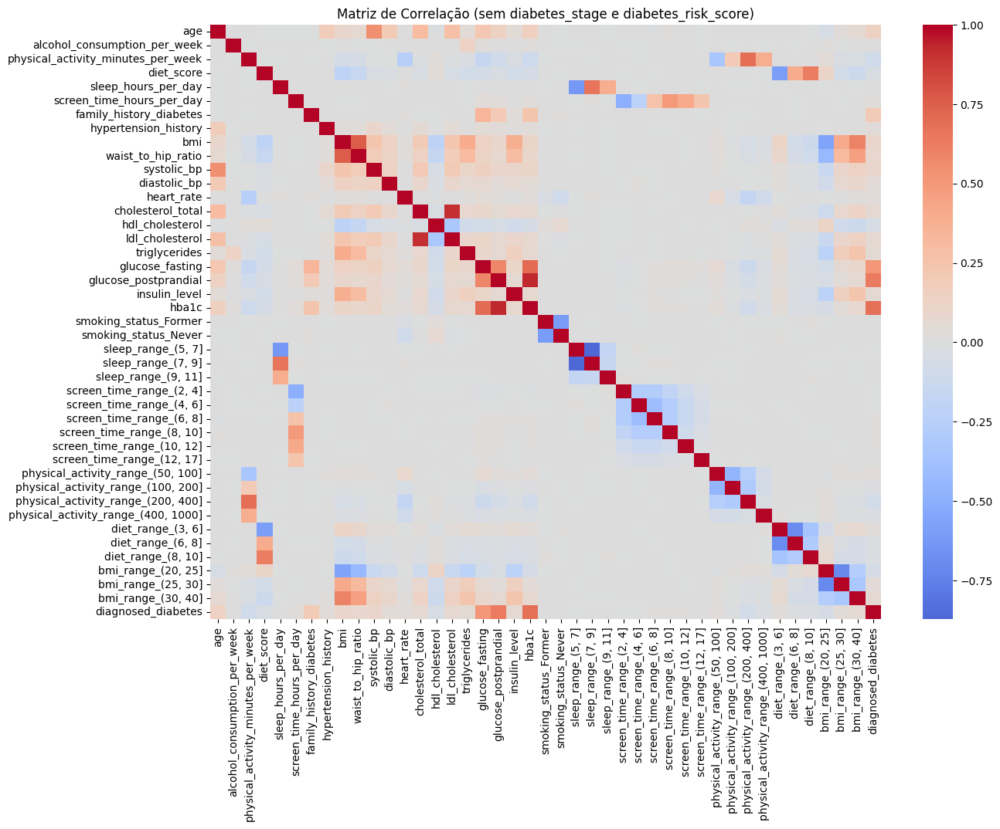

In [79]:
plt.figure(figsize=(14,10))
sns.heatmap(df_processed.corr(numeric_only=True), cmap='coolwarm', center=0, annot=False)
plt.title("Matriz de Correlação (sem diabetes_stage e diabetes_risk_score)")
plt.show()


# Modelagem

In [80]:
# Define X e y
X_preprocessed = df_processed.drop(columns=['diagnosed_diabetes'])
y = df_processed['diagnosed_diabetes']

# Divide em treino e teste
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X_preprocessed, y,
    test_size=0.2,
    random_state=42,
    stratify=y
)

print("Shape X_train:", X_train.shape)
print("Shape X_test:", X_test.shape)
print("Shape y_train:", y_train.shape)
print("Shape y_test:", y_test.shape)


Shape X_train: (80000, 42)
Shape X_test: (20000, 42)
Shape y_train: (80000,)
Shape y_test: (20000,)


In [81]:
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, recall_score

# Escalonando os dados (KNN é sensível à escala)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Criando e treinando o modelo KNN
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train_scaled, y_train)

# Fazendo previsões
y_pred_knn = knn.predict(X_test_scaled)

# Avaliando
print("Recall da classe 1:", recall_score(y_test, y_pred_knn))
print("\nRelatório de Classificação:\n")
print(classification_report(y_test, y_pred_knn))


Recall da classe 1: 0.8185833333333333

Relatório de Classificação:

              precision    recall  f1-score   support

           0       0.72      0.72      0.72      8000
           1       0.81      0.82      0.82     12000

    accuracy                           0.78     20000
   macro avg       0.77      0.77      0.77     20000
weighted avg       0.78      0.78      0.78     20000



In [82]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, recall_score

# Criando e treinando o modelo Random Forest
rf = RandomForestClassifier(
    n_estimators=100,     # número de árvores
    max_depth=None,       # deixa as árvores crescerem até o limite natural
    random_state=42,      # para reprodutibilidade
    n_jobs=-1             # usa todos os núcleos da CPU
)
rf.fit(X_train, y_train)

# Fazendo previsões
y_pred_rf = rf.predict(X_test)

# Avaliando
print("Recall da classe 1:", recall_score(y_test, y_pred_rf))
print("\nRelatório de Classificação:\n")
print(classification_report(y_test, y_pred_rf))


Recall da classe 1: 0.8665

Relatório de Classificação:

              precision    recall  f1-score   support

           0       0.83      1.00      0.91      8000
           1       1.00      0.87      0.93     12000

    accuracy                           0.92     20000
   macro avg       0.92      0.93      0.92     20000
weighted avg       0.93      0.92      0.92     20000



                               Feature  Importance
20                               hba1c    0.438682
18                glucose_postprandial    0.195747
17                     glucose_fasting    0.088865
0                                  age    0.017815
2   physical_activity_minutes_per_week    0.017518
8                                  bmi    0.016249
16                       triglycerides    0.016175
19                       insulin_level    0.015704
13                   cholesterol_total    0.015210
15                     ldl_cholesterol    0.014794


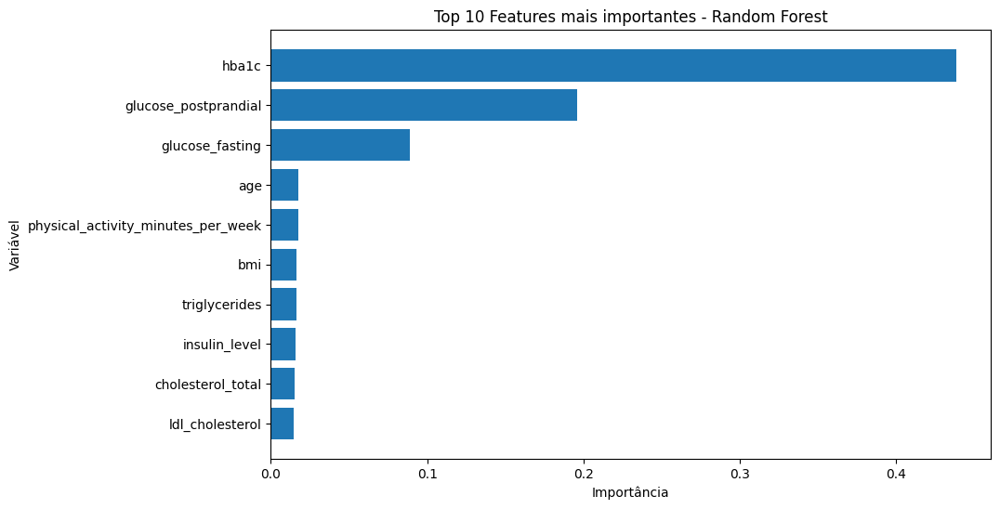

In [83]:
import pandas as pd
import matplotlib.pyplot as plt

# Pegando a importância das features
importances = rf.feature_importances_

# Criando um DataFrame para organizar
feature_importance_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': importances
}).sort_values(by='Importance', ascending=False)

# Exibindo as 10 mais importantes
print(feature_importance_df.head(10))

# Plotando o gráfico
plt.figure(figsize=(10,6))
plt.barh(feature_importance_df['Feature'][:10], feature_importance_df['Importance'][:10])
plt.gca().invert_yaxis()
plt.title('Top 10 Features mais importantes - Random Forest')
plt.xlabel('Importância')
plt.ylabel('Variável')
plt.show()


In [84]:
# Lista de colunas a serem removidas
colunas_remover = [
    'smoking_status_Former',
    'smoking_status_Never',
    'sleep_range_(5, 7]',
    'sleep_range_(7, 9]',
    'sleep_range_(9, 11]',
    'screen_time_range_(2, 4]',
    'screen_time_range_(4, 6]',
    'screen_time_range_(6, 8]',
    'screen_time_range_(8, 10]',
    'screen_time_range_(10, 12]',
    'screen_time_range_(12, 17]',
    'physical_activity_range_(50, 100]',
    'physical_activity_range_(100, 200]',
    'physical_activity_range_(200, 400]',
    'physical_activity_range_(400, 1000]',
    'diet_range_(3, 6]',
    'diet_range_(6, 8]',
    'diet_range_(8, 10]',
    'bmi_range_(20, 25]',
    'bmi_range_(25, 30]',
    'bmi_range_(30, 40]'
]

# Removendo colunas do treino e teste (ignorando se alguma não existir)
X_train = X_train.drop(columns=colunas_remover, errors='ignore')
X_test = X_test.drop(columns=colunas_remover, errors='ignore')

print("Colunas removidas com sucesso. Novo shape do X_train:", X_train.shape)


Colunas removidas com sucesso. Novo shape do X_train: (80000, 21)


In [85]:
rf.fit(X_train, y_train)
y_pred_rf = rf.predict(X_test)

print("Recall da classe 1:", recall_score(y_test, y_pred_rf))
print("\nRelatório de Classificação:\n")
print(classification_report(y_test, y_pred_rf))


Recall da classe 1: 0.8665

Relatório de Classificação:

              precision    recall  f1-score   support

           0       0.83      1.00      0.91      8000
           1       1.00      0.87      0.93     12000

    accuracy                           0.92     20000
   macro avg       0.92      0.93      0.92     20000
weighted avg       0.93      0.92      0.92     20000

